In [1]:
import tensorflow as tf
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random
import h5py
import datetime
from numpy import array, argmax
from sklearn.metrics import accuracy_score
import pickle
from PIL import Image 
from keras.utils import to_categorical

%matplotlib inline

Using TensorFlow backend.


## Read data

In [2]:
with h5py.File('D:/test.hdf5', 'r') as f:
    test_data = f["test 54_54"][:]
    test_labels = f["test labels 54_54"][:]
    test_coordinates = f["test coordinates 54_54"][:]    

OSError: Unable to open file (unable to open file: name = 'D:/test.hdf5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [19]:
pickle_file = os.path.join("SVHN", 'test.pickle')
with open(pickle_file, 'rb') as f:
    test_dataset = pickle.load(f)

In [3]:
pickle_file = os.path.join("SVHN", 'validation.pickle')
with open(pickle_file, 'rb') as f:
    test_dataset = pickle.load(f)

In [5]:
def get_box_coordinates_and_label(boxes):
    
    # Get digits bounding boxes and labels
    top = []; left = []; height = []; width = []; 
    label = np.array([10.0]*3); coordinates = np.zeros((3,4))
    for i in range(len(boxes)): 
        top.append(boxes[i]['top'])
        left.append(boxes[i]['left'])
        height.append(boxes[i]['height'])
        width.append(boxes[i]['width'])
        if boxes[i]["label"] == 10:
            label[i] = 0.0
        else:
            label[i] = boxes[i]["label"]
        coordinates[i] = [boxes[i]['top'], boxes[i]['top'] + boxes[i]['height'],
                         boxes[i]['left'], boxes[i]['left'] + boxes[i]['width']]
    box_top = np.amin(top)
    box_left = np.amin(left)
    box_bottom = np.amax(top) + height[np.argmax(top)] 
    box_right = np.amax(left) + width[np.argmax(left)] 
    box_width = box_right - box_left
    box_height = box_bottom - box_top

    return box_top, box_left, box_bottom, box_right, box_width, box_height, label, coordinates

def get_number(ind, data, arg_max = True):

    num = ""
    empty = False
    for i in range(3):
        if arg_max is True:
            digit = argmax(data[i])
        else:
            digit = data[i]
        if int(digit) is not 10:
            num += str(digit)
            if empty is True:
                print("Number ind:%d predicted %d is epmty and %d is not" % (ind, i,i+1))
        else:
            empty = True
        if i is 2:
            empty = False
    return num

def correct_coordinate(coordinate, length, threshold):
    if coordinate >  threshold:
        length -= (coordinate - threshold)
        coordinate = threshold
    return coordinate, length

def generate_dataset(dataset, WIDTH, HEIGHT, crop = True):
    
    pixel_depth = 255.0  # Number of levels per pixel.   
    images = np.ndarray(shape=(len(dataset), HEIGHT, WIDTH, 3),
                         dtype=np.float32)
    labels = np.ndarray(shape=(len(dataset), 3, 11))
    coordinates = np.ndarray(shape=(len(dataset), 4))
    scales = np.ndarray(shape=(len(dataset), 3))
    num_image = 0
    
    for i in range(len(dataset)):
        
        # Skip images with more then 5 digits
        if len(dataset[i]["boxes"]) > 3:
            continue
        
        # Read image
        image = Image.open(dataset[i]['filename'])
        scale = [image.size[0]/WIDTH, image.size[1]/HEIGHT, i]
        box_top, box_left, box_bottom, box_right, box_width, box_height, label, coord = get_box_coordinates_and_label(dataset[i]["boxes"])
        box_bottom, box_height = correct_coordinate(box_bottom, box_height, image.size[1])
        box_right, box_width = correct_coordinate(box_right, box_width, image.size[0])
        
        if box_width * box_height / (image.size[0] * image.size[1]) < 0.15:
            continue
        
        # Cropping the expanded bounding box 
        if crop: 
            image = image.crop((box_left, box_top, box_right, box_bottom))
        image = image.resize([WIDTH, HEIGHT])
        #Convert image to the grey scale and then normalize it
        #normalized_image = (np.mean(image_data, axis = 2) - pixel_depth / 2)/ pixel_depth
        normalized_image = (np.array(image) - pixel_depth / 2)/ pixel_depth
        images[num_image, :, :,:] = normalized_image
        labels[num_image, :, :] =  to_categorical(label, num_classes=11)
        coordinates[num_image, :] = [np.floor(box_top/scale[1]), np.ceil(box_bottom/scale[1]), 
                                     np.floor(box_left/scale[0]), np.ceil(box_right/scale[0])]
        #coordinates[num_image, :] = [box_top, box_bottom, box_left, box_right]
        scales[num_image, :] = scale
        num_image+=1

    return images[:num_image], labels[:num_image], coordinates[:num_image], scales[:num_image]

In [6]:
test_data, test_labels, test_coordinates, scales = generate_dataset(test_dataset, 64, 48, crop = False)
test_coordinates[:,:2] = test_coordinates[:,:2]/ 48.0
test_coordinates[:,2:] = test_coordinates[:,2:]/ 64.0
len(test_coordinates)

4006

In [7]:
def intersection_over_union(boxA, boxB):
    # determine the (x, y)-coordinates of the intersection rectangle
    
    yA = max(boxA[0], boxB[0])
    yB = min(boxA[1], boxB[1])
    xA = max(boxA[2], boxB[2])
    xB = min(boxA[3], boxB[3])
    

    # compute the area of intersection rectangle
    interArea = max(0, xB - xA) * max(0, yB - yA)
    if interArea == 0:
        return 0
    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = (boxA[1] - boxA[0]) * (boxA[3] - boxA[2])
    boxBArea = (boxB[1] - boxB[0]) * (boxB[3] - boxB[2])

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / (float(boxAArea + boxBArea - interArea) +0.0001)

    # return the intersection over union value
    return iou

def calculate_error(model_path, dataset, labels, box, fix_coord = False):
    
    batch_size = 500
    IoU = []
    steps = len(dataset)// batch_size

    with tf.Session(graph=graph) as session:
        reader = tf.train.NewCheckpointReader(model_path)
        reader.get_variable_to_shape_map()
        saver.restore(session, model_path)
        print('Model restored.')

        for j in range(steps):

            offset = (j * batch_size) 
            batch_data = dataset[offset:(offset + batch_size), :, :, :] 
            batch_coordinates = box[offset:(offset + batch_size)] 

            feed_dict={tf_val_dataset: batch_data }
            curr_pred_box = session.run(val_box_vertexes, feed_dict=feed_dict)

            predictions = np.copy(curr_pred_box)
            curr_pred_box[:,1] = predictions[:,0] + predictions[:,2]
            curr_pred_box[:,2] = predictions[:,1]
            curr_pred_box[:,3] = predictions[:,1] + predictions[:,3]
            
            coord = np.copy(batch_coordinates)
            if fix_coord:
                coord[:,1] = batch_coordinates[:,0] + batch_coordinates[:,2]
                coord[:,2] = batch_coordinates[:,1]
                coord[:,3] = batch_coordinates[:,1] + batch_coordinates[:,3]
            
            curr_box_Iou = []
            for i in range(len(curr_pred_box)):
                aaa = intersection_over_union(curr_pred_box[i], coord[i]) 
                curr_box_Iou.append(aaa)
            IoU.append(np.mean(curr_box_Iou))
                
            if j is 0:
                pred_boxes = curr_pred_box
                coordinates = coord
                print("pred",predictions[0])
                print("Reaxed pred",curr_pred_box[0]) 
                print("True coord",batch_coordinates[0])
            else:
                pred_boxes = np.append(pred_boxes, curr_pred_box, axis = 0)
                coordinates = np.append(coordinates, coord, axis = 0)
        print(IoU)
        print('Test calculated (IoU): (%.2f)' % ( np.mean(IoU)*100))
    return pred_boxes, coordinates


In [ ]:
#atkopijuotas is 5 notebook
def calculate_error(model_path, dataset, labels, box, calculate_whole_box =True):
    
    index = ["First digit", "Second digit", "Third digit", "Average", "IoU"]
    batch_size = 500
    IoU = [] ;acc1 = []; acc2 = []; acc3 = []; acc = []; pred = []
    steps = len(dataset)// batch_size
    with tf.Session(graph=graph) as session:
        reader = tf.train.NewCheckpointReader(model_path)
        reader.get_variable_to_shape_map()
        saver.restore(session, model_path)
        print('Model restored.')

        for j in range(steps):

            offset = (j * batch_size) % (len(dataset) - batch_size)
            batch_data = dataset[offset:(offset + batch_size), :, :, :]
            batch_labels = labels[offset:(offset + batch_size)]    
            batch_coordinates = box[offset:(offset + batch_size)] 

            feed_dict={tf_val_dataset: batch_data,
                       tf_val_labels: batch_labels,
                       tf_val_box: batch_coordinates[:,:4],
                      }
           
            batch_IoU, batch_pred, batch_box_pred = \
                    session.run( [validation_IoU,  validate_predictions, val_box_vertexes], feed_dict=feed_dict)

            acc1.append(calculate_digit_acc(batch_pred, batch_labels, 0))
            acc2.append(calculate_digit_acc(batch_pred, batch_labels, 1))
            acc3.append(calculate_digit_acc(batch_pred, batch_labels, 2))  
            acc.append(np.mean([acc1,acc2,acc3]))
            IoU.append(batch_IoU)
            pred = np.append(pred, batch_box_pred)
            
        IoU = np.mean(IoU) 
        acc1 = np.mean(acc1); acc2 = np.mean(acc2);
        acc3 = np.mean(acc3); acc = np.mean(acc)  
             
        df = pd.DataFrame([acc1, acc2, acc3, acc, IoU], index).transpose().round(4)*100
        df = df.rename(index={0: '%'})
    return df, pred.reshape(-1, 4)

In [30]:
%%time
with h5py.File('SVHN_reg4.hdf5', 'r') as f:    
    test_data = f["validate"][:]
    test_labels = f["validate labels"][:]
    test_coordinates = f["validate coordinates"][:]
    
test_coordinates[:,[0,2]] = test_coordinates[:,[0,2]]/ 48.0
test_coordinates[:,[1,3]] = test_coordinates[:,[1,3]]/ 64.0

Wall time: 1.1 s


In [8]:
if True:
    #%run "Models//Model_reg91//Model91.py" #load graph
    #model_path = os.path.join( "Models","Model_reg91" ,"Classification91_3.ckpt")
    %run "Models//Model_reg94//Model94_reg.py" #load graph
    model_path = os.path.join( "Models","Model_reg94" ,"Classification94_5.ckpt") 
    #%run "Models//Model_reg81//Model81.py" #load graph
    #model_path = os.path.join( "Models","Model_reg81" ,"Classification81_20.ckpt") 
else:
    #%run "Models//Model_reg82//Model82.py" #load graph
    #model_path = os.path.join( "Models","Model_reg82" ,"Classification82_12.ckpt")
    %run "Models//Model_reg66//Model.py" #load graph
    model_path = os.path.join( "Models","Model_reg66" ,"Classification66_11.ckpt")
#box = calculate_error(model_path, validate_data[:9000], validate_labels[:9000], validate_coordinates[:9000])
box, coordinates = calculate_error(model_path, test_data, test_labels, test_coordinates, False)

INFO:tensorflow:Restoring parameters from Models\Model_reg94\Classification94_5.ckpt
Model restored.
pred [0.07143396 0.436216   0.880561   0.4569384 ]
Reaxed pred [0.07143396 0.95199496 0.436216   0.8931544 ]
True coord [0.14583333 0.75       0.4375     0.734375  ]
[0.6011743710030513, 0.5993095395987782, 0.6015223550454933, 0.6137618407112447, 0.6058085563963858, 0.5998342664178412, 0.6128440057365342, 0.6060804430328539]
Test calculated (IoU): (60.50)


In [9]:
len(test_coordinates)

4006

In [3]:
index = 60
display(test_data[index:index+30]*255.0+127.5, np.copy(test_coordinates[index:index+30]), np.copy(box[index:index+30]), coord= False)

NameError: name 'test_data' is not defined

In [59]:
len(np.copy(box))

4000

In [10]:
def crop_image(dataset, coordinates, WIDTH, HEIGHT, scales, margin = 0):
    
   
    images = np.ndarray(shape=(len(coordinates), HEIGHT, WIDTH, 3),
                         dtype=np.float32)
    num_image = 0
        
    for i in scales[:,2].astype(int)[:len(coordinates)]:
        #print(coordinates[num_image])
        image = Image.open(dataset[i]['filename'])
        coordinates[num_image, :2] = coordinates[num_image, :2] * scales[num_image, 1] * 48
        coordinates[num_image, 2:] = coordinates[num_image, 2:] * scales[num_image, 0] * 64
        #print(coordinates[num_image])
        #print("+==========================-")
       # image = image.crop((box_left, box_top, box_right, box_bottom))
        image = image.crop((max(coordinates[num_image, 2]- margin,0), max(coordinates[num_image, 0]-margin, 0), 
                            min(coordinates[num_image, 3]+margin, image.size[0]), min(coordinates[num_image, 1]+margin, image.size[1])))
        image = image.resize([WIDTH, HEIGHT])   
        images[num_image, :, :,:] = image
        num_image += 1

    return images

crop_data =  crop_image(test_dataset, np.copy(box), 54, 54, scales, 1)


In [ ]:
#60
D1: 0.910  D2: 0.903  D3: 0.913  
Validate digit acc: 0.910520
Validate number acc: 0.846295
#60 su 91reg
D1: 0.672  D2: 0.623  D3: 0.685  
Validate digit acc: 0.658592
Validate number acc: 0.385921
#60 su 82
D1: 0.858  D2: 0.848  D3: 0.883  
Validate digit acc: 0.860514
Validate number acc: 0.714678
#94 su 82 reg  
D1: 0.884  D2: 0.845  D3: 0.907  
Validate digit acc: 0.882629
Validate number acc: 0.741388
#94 su 84 reg  
D1: 0.886  D2: 0.839  D3: 0.912  
Validate digit acc: 0.880980
Validate number acc: 0.732651

In [14]:
#model_path = os.path.join( "Models","Model_reg81" ,"Classification81_20.ckpt")
%run "Models//Model94//Model94.py" #load graph
model_path = os.path.join( "Models","Model94" ,"Classification94_4.ckpt")

def calculate_digit_acc(pred_label, label, i):
  digit_label = argmax(label[:,i,:], axis = 1)
  acc = accuracy_score(pred_label[i], digit_label)
  return acc

def evaluate_approach(data, labels, model_path, batch_size = 600):
    
    error_data = []
    acc1 = []; acc2 = []; acc3 = []; acc = []
    steps = len(data)// batch_size
    
    
    with tf.Session(graph=graph) as session:
        reader = tf.train.NewCheckpointReader(model_path)
        reader.get_variable_to_shape_map()
        saver.restore(session, model_path)
        print('Model restored.')  

        for j in range(steps):

            offset = (j * batch_size)#!!
            batch_data = data[offset:(offset + batch_size), :, :, :]
            batch_labels = labels[offset:(offset + batch_size), :]    
            #batch_pred = validate_predictions.eval(feed_dict={tf_val_dataset: batch_data})#81
            batch_pred = validate_prediction.eval(feed_dict={tf_validate_dataset : batch_data})
            print(j)
            for k in range(len(batch_data)):
                actual_number = get_number(j*batch_size+k, batch_labels[k])
                pred_number = get_number(j*batch_size+k, batch_pred[:,k], arg_max = False)
                if actual_number != pred_number:
                    #print(actual_number, pred_number)
                    error_data.append((j*batch_size+k, pred_number, actual_number))

            acc1.append(calculate_digit_acc(batch_pred, batch_labels, 0))
            acc2.append(calculate_digit_acc(batch_pred, batch_labels, 1))
            acc3.append(calculate_digit_acc(batch_pred, batch_labels, 2))  
            acc.append(np.mean([acc1,acc2,acc3]))

    acc1 = np.mean(acc1); acc2 = np.mean(acc2); acc3 = np.mean(acc3) 
    acc = np.mean(acc)
    print(steps)
    print('D1: %.3f  D2: %.3f  D3: %.3f  ' % (acc1, acc2, acc3))
    print('Validate digit acc: %f' % (acc))
    print('Validate number acc: %f' % (1 - len(error_data)/len(test_data)))   
    
    return error_data, batch_pred

error_data, batch_pred = evaluate_approach(crop_data, test_labels, model_path, batch_size = 500)

INFO:tensorflow:Restoring parameters from Models\Model94\Classification94_4.ckpt
Model restored.
0
Number ind:29 predicted 2 is epmty and 3 is not
1
2
Number ind:1414 predicted 2 is epmty and 3 is not
Number ind:1468 predicted 2 is epmty and 3 is not
3
Number ind:1819 predicted 2 is epmty and 3 is not
4
Number ind:2005 predicted 2 is epmty and 3 is not
5
6
Number ind:3186 predicted 2 is epmty and 3 is not
7
Number ind:3660 predicted 2 is epmty and 3 is not
8
D1: 0.886  D2: 0.839  D3: 0.912  
Validate digit acc: 0.880980
Validate number acc: 0.732651


In [22]:
%run "Models//Model_reg81//Model81.py" #load graph
model_path = os.path.join( "Models","Model_reg81" ,"Classification81_20.ckpt")
#%run "Models//Model_reg94//Model94_reg.py" #load graph
#model_path = os.path.join( "Models","Model_reg94" ,"Classification94_5.ckpt")

def calculate_digit_acc(pred_label, label, i):
  digit_label = argmax(label[:,i,:], axis = 1)
  acc = accuracy_score(pred_label[i], digit_label)
  return acc

def evaluate_approach(data, labels, model_path, batch_size = 600):
    
    error_data = []
    acc1 = []; acc2 = []; acc3 = []; acc = []
    steps = len(data)// batch_size
    
    
    with tf.Session(graph=graph) as session:
        reader = tf.train.NewCheckpointReader(model_path)
        reader.get_variable_to_shape_map()
        saver.restore(session, model_path)
        print('Model restored.')  

        for j in range(steps):

            offset = (j * batch_size)#!!
            batch_data = data[offset:(offset + batch_size), :, :, :]
            batch_labels = labels[offset:(offset + batch_size), :]    
            batch_pred = validate_predictions.eval(feed_dict={tf_val_dataset: batch_data})#81
            #batch_pred = validate_prediction.eval(feed_dict={tf_validate_dataset : batch_data})
            print(j)
            for k in range(len(batch_data)):
                actual_number = get_number(j*batch_size+k, batch_labels[k])
                pred_number = get_number(j*batch_size+k, batch_pred[:,k], arg_max = False)
                if actual_number != pred_number:
                    #print(actual_number, pred_number)
                    error_data.append((j*batch_size+k, pred_number, actual_number))

            acc1.append(calculate_digit_acc(batch_pred, batch_labels, 0))
            acc2.append(calculate_digit_acc(batch_pred, batch_labels, 1))
            acc3.append(calculate_digit_acc(batch_pred, batch_labels, 2))  
            acc.append(np.mean([acc1,acc2,acc3]))

    acc1 = np.mean(acc1); acc2 = np.mean(acc2); acc3 = np.mean(acc3) 
    acc = np.mean(acc)
    print(steps)
    print('D1: %.3f  D2: %.3f  D3: %.3f  ' % (acc1, acc2, acc3))
    print('Validate digit acc: %f' % (acc))
    print('Validate number acc: %f' % (1 - len(error_data)/len(test_data)))   
    
    return error_data, batch_pred

error_data, batch_pred = evaluate_approach(test_data, test_labels, model_path, batch_size = 500)

Model 82 loaded.
INFO:tensorflow:Restoring parameters from Models\Model_reg81\Classification81_20.ckpt


INFO:tensorflow:Restoring parameters from Models\Model_reg81\Classification81_20.ckpt


Model restored.
0
Number ind:401 predicted 1 is epmty and 2 is not
1
2
Number ind:1297 predicted 1 is epmty and 2 is not
3
4
Number ind:2224 predicted 1 is epmty and 2 is not
5
Number ind:2730 predicted 1 is epmty and 2 is not
6
Number ind:3035 predicted 1 is epmty and 2 is not
Number ind:3176 predicted 1 is epmty and 2 is not
7
8
D1: 0.699  D2: 0.580  D3: 0.812  
Validate digit acc: 0.697915
Validate number acc: 0.406640


In [8]:
import matplotlib.patches as patches
def display(data, labels, pred_box, coord = True):
    plt.rcParams['figure.figsize'] = (12.0, 20)
    f, ax = plt.subplots(nrows=10, ncols=3)
    
    if coord:
        labels[:,[0,2]] = labels[:,[0,2]]* 48.0
        labels[:,[1,3]] = labels[:,[1,3]]* 64.0
        pred_box[:,[0,2]] = pred_box[:,[0,2]]* 48.0
        pred_box[:,[1,3]] = pred_box[:,[1,3]]* 64.0
    else:
        pred_box[:,:2]= pred_box[:,:2] * 48.0
        pred_box[:,2:]= pred_box[:,2:] * 64.0
        labels[:,:2]= labels[:,:2] * 48.0
        labels[:,2:]= labels[:,2:] * 64.0
    for ind in range(30):
        j = ind % 3; i = int(np.floor(ind /3))
        #ax[i][j].axis('off')
        ax[i][j].imshow(data[ind]*255.0+127.5)
        #ax[i][j].set_title(SVHN_labels[ind,1:])
        pred_rect = patches.Rectangle((pred_box[ind,2],pred_box[ind,0]),pred_box[ind,3]-pred_box[ind,2],
                                 pred_box[ind,1]-pred_box[ind,0], linewidth=2, edgecolor='b', facecolor='none')
        rect = patches.Rectangle((labels[ind,2],labels[ind,0]), labels[ind,3]-labels[ind,2],
                                 labels[ind,1]-labels[ind,0], linewidth=2, edgecolor='r', facecolor='none')
        ax[i][j].add_patch(rect)
        ax[i][j].add_patch(pred_rect)

In [118]:
print(test_coordinates[0]*48)
print(coordinates[0])
print(box[0])
[ 7.         38.         20.25       30.75      ]

[ 7.   38.   20.25 30.75]
[0.14583333 0.79166667 0.421875   0.640625  ]
[0.12554955 0.9234468  0.3770712  0.708554  ]


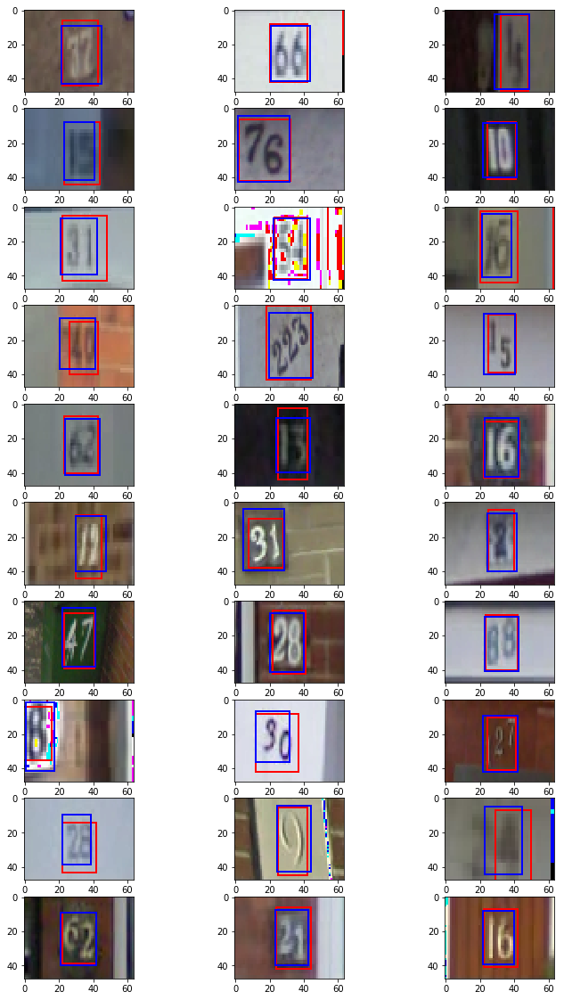

In [172]:
index = 60
display(test_data[index:index+30]*255.0+127.5, np.copy(test_coordinates[index:index+30]), np.copy(box[index:index+30]), coord= False)

In [12]:
def intersection_over_union(boxA, boxB):
    # determine the (x, y)-coordinates of the intersection rectangle
    
    yA = max(boxA[0], boxB[0])
    yB = min(boxA[1], boxB[1])
    xA = max(boxA[2], boxB[2])
    xB = min(boxA[3], boxB[3])
    

    # compute the area of intersection rectangle
    interArea = max(0, xB - xA) * max(0, yB - yA)
    if interArea == 0:
        return 0
    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = (boxA[1] - boxA[0]) * (boxA[3] - boxA[2])
    boxBArea = (boxB[1] - boxB[0]) * (boxB[3] - boxB[2])

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / (float(boxAArea + boxBArea - interArea) +0.0001)

    # return the intersection over union value
    return iou

In [73]:
def intersection_over_union(boxA, boxB):
    # determine the (x, y)-coordinates of the intersection rectangle
    
    yA = max(boxA[0], boxB[0])
    yB = min(boxA[1], boxB[1])
    xA = max(boxA[2], boxB[2])
    xB = min(boxA[3], boxB[3])
    

    # compute the area of intersection rectangle
    interArea = max(0, xB - xA) * max(0, yB - yA)
    if interArea == 0:
        return 0
    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = (boxA[1] - boxA[0]) * (boxA[3] - boxA[2])
    boxBArea = (boxB[1] - boxB[0]) * (boxB[3] - boxB[2])

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / (float(boxAArea + boxBArea - interArea) +0.0001)

    # return the intersection over union value
    return iou

def tf_IoU(x1, x2):
    eps =  tf.constant(0.0001)
    #y11, y12, x11, x12 = tf.split(x1, 4, axis=1)
    #y21, y22, x21, x22 = tf.split(x2, 4, axis=1)
    y11, x11, h1, w1 = tf.split(x1, 4, axis=1)
    y21, x21, h2, w2 = tf.split(x2, 4, axis=1)


    xA = tf.maximum(x11, x21)
    yA = tf.maximum(y11, y21)
    #xB = tf.minimum(x12, x22)
    #yB = tf.minimum(y12, y22)
    xB = tf.minimum(x11 + w1, x21 + w2)
    yB = tf.minimum(y11 + h1, y21 + h2)

    interArea = tf.maximum((xB - xA), 0) * tf.maximum((yB - yA), 0)

    boxAArea = w1 * h1 #(x12 - x11) * (y12 - y11)  #w1 * h1
    boxBArea = w2 * h2 #(x22 - x21) * (y22 - y21) #w2 * h2#

    
    IoU = tf.reduce_mean(interArea / (boxAArea + boxBArea - interArea + eps))

    return IoU

def tf_acc(pred_label, actual_label):
    acc = tf.reduce_mean(tf.cast(tf.equal(pred_label, actual_label), tf.float32))
    return acc

def calculate_digit_acc(pred_label, label, i):
  digit_label = argmax(label[:,i,:], axis = 1)
  acc = accuracy_score(pred_label[i], digit_label)
  return acc

def calculate_digit_acc_tf(pred_label, label, i):
  digit_label = tf.argmax(label[:,i,:], axis = 1)
  acc = tf.reduce_mean(tf.cast(tf.equal(pred_label[i], digit_label), tf.float32))
  return acc

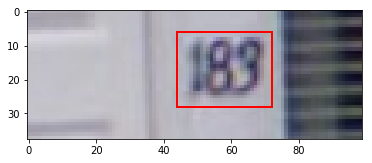

In [9]:
import matplotlib.patches as patches

def show_image(dataset, WIDTH, HEIGHT, indexes, raw = True, box_coordinates = []):
    pixel_depth = 255.0  # Number of levels per pixel.   
    images = np.ndarray(shape=(len(dataset), HEIGHT, WIDTH, 3),
                         dtype=np.float32)
    labels = np.ndarray(shape=(len(dataset), 3, 11))
    coordinates = np.ndarray(shape=(len(dataset), 4))
    scales = np.ndarray(shape=(len(dataset), 2))
    num_image = 0
    
    for i in indexes:
        
        if raw:
        # Skip images with more then 5 digits
            if len(dataset[i]["boxes"]) > 3:
                continue
        
            # Read image
            image = Image.open(dataset[i]['filename'])
            scale = [image.size[0]/WIDTH, image.size[1]/HEIGHT]
            box_top, box_left, box_bottom, box_right, box_width, box_height, \
                label, coord = get_box_coordinates_and_label(dataset[i]["boxes"])
        else:
            image = dataset[i]
            [box_top, box_bottom, box_right, box_left] = box_coordinates[i]
            box_top, box_bottom, box_right, box_left = box_top *48, box_bottom*48, box_right*64, box_left*64
 
        
        fig,ax = plt.subplots(1)        
        ax.imshow(image)
        rect = patches.Rectangle((box_left, box_top), box_right-box_left,box_bottom-box_top, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)


show_image(test_dataset, 64, 48, [int(scales[0,2])])

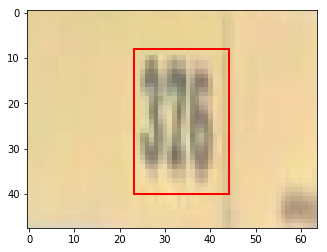

In [28]:
show_image(test_data*255.0 +127.5, 64, 48, [10], False, box_coordinates=box)

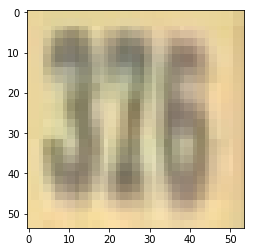

In [29]:
plt.imshow(crop_data[10])

In [ ]:
x

In [2]:
paths = os.listdir("Camera")
image = Image.open("Camera//" + paths[10])
#plt.imshow(cv2.resize(np.array(image)[900:2200,1700:3000], (54, 54)))

In [3]:
image.size[0]

4160

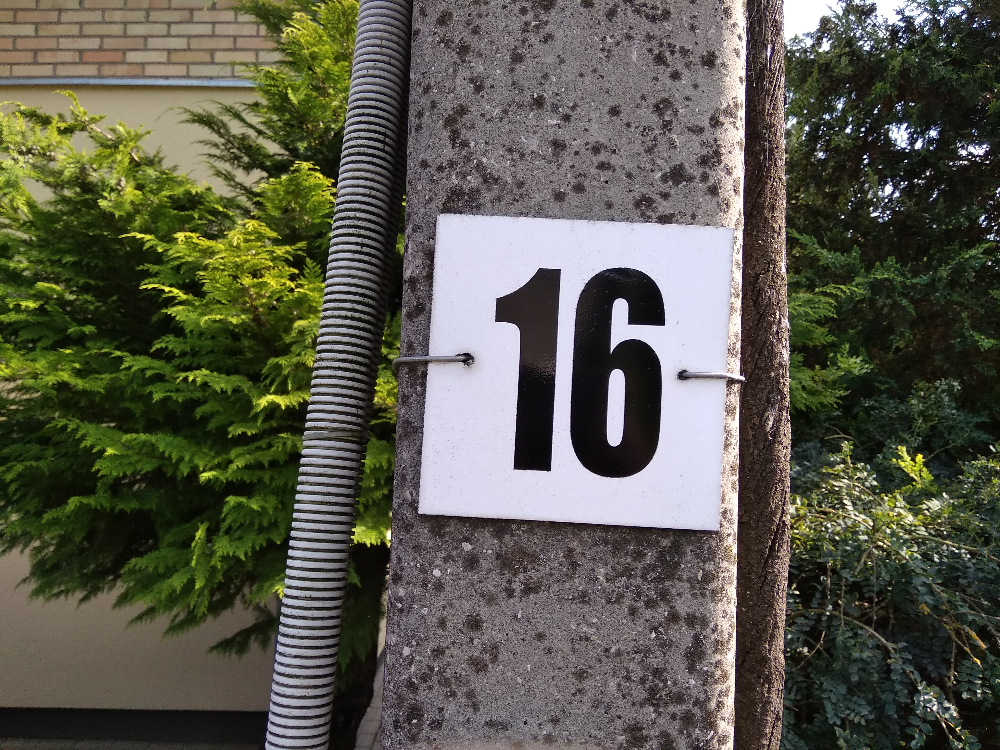

In [4]:
image

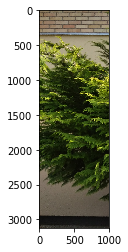

In [22]:
plt.imshow(np.array(image)[:,:1000])

In [ ]:
image.reshape(54,)

In [4]:
b = ((cv2.resize(np.array(image)[1000:2200,1700:3000], (54, 54)) - 255.0/2) / 255).reshape(1,54,54,3)

In [5]:
%run "Models//Model60//Model60.py" #load graph
model_path = os.path.join( "Models","Model60" ,"Classification60.ckpt")

with tf.Session(graph=graph) as session:
    reader = tf.train.NewCheckpointReader(model_path)
    reader.get_variable_to_shape_map()
    saver.restore(session, model_path)
    batch_pred = validate_prediction.eval(feed_dict={tf_validate_dataset : b})
batch_pred

INFO:tensorflow:Restoring parameters from Models\Model60\Classification60.ckpt


array([[ 1],
       [ 6],
       [10]], dtype=int64)

In [1]:
import pandas as pd

In [12]:
index = ["as", "tu", "mes abu"]
data = [[0.5, 10,"-"], [0.4, 15,1]]
  
# Create the pandas DataFrame 
#df = pd.DataFrame(data, columns = index) 
  
# print dataframe. 
#df = pd.DataFrame(data, index).transpose().round(4)*100
df = pd.DataFrame(data, columns = index, index = ["Regression", "Clasification"])
#df = df.rename(index={0: 'Regression', 1:"Clasification"})
df

,as,tu,mes abu
Regression,0.5,10,-
Clasification,0.4,15,1
